# Ultra-Marathon EDA (2016–2019)

> **A comprehensive exploratory analysis** of ultra-marathon races from 2016 to 2019.  
> We’ll examine athlete demographics, performance, event characteristics, and seasonal trends.

---

## 📋 Table of Contents

1. [Introduction](#introduction)  
2. [Data Loading & Inspection](#data-loading)  
3. [Data Cleaning & Feature Engineering](#data-cleaning)  
4. [Exploratory Analysis](#exploratory)   
5. [Outlier Detection](#outlier)  

---

## <a name="introduction"></a>1. Introduction

Brief describtion:
**What is an Ultramarathon?** 
An ultramarathon, also called ultra distance or ultra running, is any footrace longer than the traditional marathon length of 42.195 kilometres (26 mi 385 yd). You can find more details on the <a href="https://www.kaggle.com/datasets/aiaiaidavid/the-big-dataset-of-ultra-marathon-running" target="_blank">
Kaggle dataset page </a>.

**Dataset Overview**  
Dataset size is (7.4 M rows, 13 cols) registered between 1798 and 2022. For this analysis, we focus on the **2016–2019** window (2.5 M rows, 10 core columns) because:
- **Pre-2015** data are often incomplete or inconsistently formatted  
- **Post-2019** entries drop sharply due to COVID-19 cancellations 

**Objectives** 
Key questions you’ll answer (age & performance, seasonality, country comparisons).
1. **Demographics**: What are the age and gender profiles of ultra-runners?  
2. **Seasonality & Geography**: When and where do the fastest races occur?  

By the end, you’ll see a clear picture of who runs ultras, how they perform, and how the sport has evolved in the modern era.

---


## <a name="data-loading"></a>2. Data Loading & Inspection

### 2.1 Downloading & Loading the Data

In [1]:
%pip install opendatasets

# importing model that downloads datasets
import opendatasets as od
print("od version", od.version())
dataset_url = 'https://www.kaggle.com/datasets/aiaiaidavid/the-big-dataset-of-ultra-marathon-running/discussion/420633'
od.download(dataset_url)

# getting local path to the datset
import os
data_dir = './the-big-dataset-of-ultra-marathon-running'
print("Direction\n", data_dir)
print("Files\n", os.listdir(data_dir))
train_csv = data_dir + '/TWO_CENTURIES_OF_UM_RACES.csv'

Note: you may need to restart the kernel to use updated packages.
od version 0.1.22
Skipping, found downloaded files in ".\the-big-dataset-of-ultra-marathon-running" (use force=True to force download)
Direction
 ./the-big-dataset-of-ultra-marathon-running
Files
 ['.ipynb_checkpoints', 'TWO_CENTURIES_OF_UM_RACES', 'TWO_CENTURIES_OF_UM_RACES.csv']


    Using opendatasets to pull the Kaggle files directly into our notebook. Loading the main CSV into a pandas DataFrame called raw_df for subsequent cleaning and analysis.

### 2.2 Importing Libraries

In [2]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
import numpy as np


raw_df = pd.read_csv(train_csv)
raw_df.head(10)

C:\Users\Laylo Karimova\AppData\Local\Temp\ipykernel_24856\1721945909.py:8: DtypeWarning: Columns (11) have mixed types. Specify dtype option on import or set low_memory=False.
  raw_df = pd.read_csv(train_csv)


,Year of event,Event dates,Event name,Event distance/length,Event number of finishers,Athlete performance,Athlete club,Athlete country,Athlete year of birth,Athlete gender,Athlete age category,Athlete average speed,Athlete ID
0,2018,06.01.2018,Selva Costera (CHI),50km,22,4:51:39 h,Tnfrc,CHI,1978.0,M,M35,10.286,0
1,2018,06.01.2018,Selva Costera (CHI),50km,22,5:15:45 h,Roberto Echeverría,CHI,1981.0,M,M35,9.501,1
2,2018,06.01.2018,Selva Costera (CHI),50km,22,5:16:44 h,Puro Trail Osorno,CHI,1987.0,M,M23,9.472,2
3,2018,06.01.2018,Selva Costera (CHI),50km,22,5:34:13 h,Columbia,ARG,1976.0,M,M40,8.976,3
4,2018,06.01.2018,Selva Costera (CHI),50km,22,5:54:14 h,Baguales Trail,CHI,1992.0,M,M23,8.469,4
5,2018,06.01.2018,Selva Costera (CHI),50km,22,6:25:01 h,NaN,ARG,1974.0,M,M40,7.792,5
6,2018,06.01.2018,Selva Costera (CHI),50km,22,6:28:00 h,Los Patagones,ARG,1979.0,F,W35,7.732,6
7,2018,06.01.2018,Selva Costera (CHI),50km,22,6:32:24 h,Reaktiva Chile,CHI,1967.0,F,W50,7.645,7
8,2018,06.01.2018,Selva Costera (CHI),50km,22,6:39:08 h,Puro Trail Osorno,CHI,1985.0,M,M23,7.516,8
9,2018,06.01.2018,Selva Costera (CHI),50km,22,6:45:11 h,Marlene Flores Team,CHI,1976.0,M,M40,7.404,9


    Dataset has ~7.46 million rows × 13 columns, data span from 1798 through 2022. 

### 2.3 Initial Inspection

In [3]:
raw_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7461195 entries, 0 to 7461194
Data columns (total 13 columns):
 #   Column                     Dtype  
---  ------                     -----  
 0   Year of event              int64  
 1   Event dates                object 
 2   Event name                 object 
 3   Event distance/length      object 
 4   Event number of finishers  int64  
 5   Athlete performance        object 
 6   Athlete club               object 
 7   Athlete country            object 
 8   Athlete year of birth      float64
 9   Athlete gender             object 
 10  Athlete age category       object 
 11  Athlete average speed      object 
 12  Athlete ID                 int64  
dtypes: float64(1), int64(3), object(9)
memory usage: 740.0+ MB


In [4]:
raw_df.head()

,Year of event,Event dates,Event name,Event distance/length,Event number of finishers,Athlete performance,Athlete club,Athlete country,Athlete year of birth,Athlete gender,Athlete age category,Athlete average speed,Athlete ID
0,2018,06.01.2018,Selva Costera (CHI),50km,22,4:51:39 h,Tnfrc,CHI,1978.0,M,M35,10.286,0
1,2018,06.01.2018,Selva Costera (CHI),50km,22,5:15:45 h,Roberto Echeverría,CHI,1981.0,M,M35,9.501,1
2,2018,06.01.2018,Selva Costera (CHI),50km,22,5:16:44 h,Puro Trail Osorno,CHI,1987.0,M,M23,9.472,2
3,2018,06.01.2018,Selva Costera (CHI),50km,22,5:34:13 h,Columbia,ARG,1976.0,M,M40,8.976,3
4,2018,06.01.2018,Selva Costera (CHI),50km,22,5:54:14 h,Baguales Trail,CHI,1992.0,M,M23,8.469,4


In [5]:
raw_df.shape

(7461195, 13)

In [6]:
raw_df["Year of event"].value_counts().sort_index()

Year of event
1798         1
1800         1
1801         4
1802         1
1805         1
         ...  
2018    661483
2019    732207
2020    224203
2021    375604
2022    471598
Name: count, Length: 146, dtype: int64

In [7]:
raw_df.dtypes

Year of event                  int64
Event dates                   object
Event name                    object
Event distance/length         object
Event number of finishers      int64
Athlete performance           object
Athlete club                  object
Athlete country               object
Athlete year of birth        float64
Athlete gender                object
Athlete age category          object
Athlete average speed         object
Athlete ID                     int64
dtype: object

## <a name="data-cleaning"></a>3. Data Cleaning & Feature Engineering
### 3.1 Filter Years

In [8]:
# taking only subset of datset from 2016 to 2019 till covid-19
subset_df = raw_df[(raw_df["Year of event"]>=2016) & (raw_df["Year of event"]<=2019)]

    To ensure we work with the most complete and consistent data while avoiding the sparsity of early records and the 
    COVID-19 disruptions after 2019 we limit our analysis to races held between **2016** and **2019**. This reduces the raw 7.4 M-row table down to a clean, modern slice of ~2.5 M events for our EDA.

In [9]:
# dropping cols that we willl not be used in our analysis
drop_cols = [
  'Athlete club',
  'Athlete age category',
  'Athlete ID',   
]
subset_df = subset_df.drop(columns=drop_cols, axis=1)

At this stage we remove fields that are not needed for our analysis, reducing memory usage and simplifying downstream code. 
The column **Athlete age category** we can derive form birth yera of athletes and event year.

In [10]:
# Changing event dates data type to datetime
subset_df['Event dates in dt'] = subset_df['Event dates'].str.extract(r'(\d{2}\.\d{2}\.\d{4})$')[0]
subset_df['Event dates in dt'] = pd.to_datetime(
    subset_df['Event dates in dt'],
    format='%d.%m.%Y',
    dayfirst=True,
    errors='coerce'
)

    Event date are now stored in object, during analysis we need them as datetime so we are converitng them into datetime 
    and saving as new column while keeping the original data as well.

In [11]:
subset_df.isna().sum()

Year of event                     0
Event dates                       0
Event name                        0
Event distance/length           563
Event number of finishers         0
Athlete performance               0
Athlete country                   0
Athlete year of birth        177499
Athlete gender                    0
Athlete average speed            25
Event dates in dt                 0
dtype: int64

In [12]:
# Event distance has 563 missing values and we are filling in these with "other" 
subset_df["Event distance/length"] = subset_df["Event distance/length"].fillna("other")
subset_df["Event distance/length"].value_counts().get("other", 0)

np.int64(563)

    We only had 563 rows out of 2.5 million missing an event distance/length—about 0.02 % of the data—so outright dropping them would throw away perfectly good performance and demographic information. By filling those few blanks with the category "other" we preserve every athlete’s record (no loss of finish times, ages, speeds, etc.) and explicitly flag them as a special “unknown” distance bucket, so if we ever inspect distance‐based trends we’ll see a small “other” bar rather than silently lumping or dropping them.

In [13]:
subset_df["Athlete average speed"] = pd.to_numeric(subset_df["Athlete average speed"],  errors='coerce')

In [14]:
from sklearn.impute import SimpleImputer

imputer = SimpleImputer(strategy="median")
subset_df["Athlete average speed"] = imputer.fit_transform(subset_df[["Athlete average speed"]])
subset_df.isna().sum()

Year of event                     0
Event dates                       0
Event name                        0
Event distance/length             0
Event number of finishers         0
Athlete performance               0
Athlete country                   0
Athlete year of birth        177499
Athlete gender                    0
Athlete average speed             0
Event dates in dt                 0
dtype: int64

    Only **25** out of ~2.5 M rows were missing a speed value (< 0.001%). To avoid dropping any records, we use scikit-learn’s `SimpleImputer(strategy='median')` to replace these gaps with the column’s median. This keeps the speed distribution intact and lets us chart speeds without nulls.


In [15]:
subset_df["Athlete birth year imputed"] = subset_df["Athlete year of birth"].isna().astype(int)

    Missing values in Athlete year of birth is almost 0.6% which is significant. So, after imputing missing speeds, we want to keep track of which runners originally lacked a birth year so we can later check for any bias this might introduce. 
    The new column `Athlete birth year imputed` is set to 1 if birth year was imputed 0 otherwise.

### 3.2 Handle Missing Year of Birth

In [16]:
# using Ridge regresiosn to handle with non linear data and to handle large 2.4 dataset faster
from sklearn.linear_model import Ridge
from sklearn.model_selection import train_test_split

# getting data with no na values in birth year to train
train_df = subset_df[subset_df["Athlete year of birth"].notna()]
# getting data with na values in birth year to test
test_df = subset_df[subset_df["Athlete year of birth"].isna()]

features = ['Athlete average speed', 'Athlete gender', 'Athlete country']
# Encoding categorical variables (gender, country, etc.)
train_X = pd.get_dummies(train_df[features], drop_first=True)
train_y = train_df["Athlete year of birth"]

test_X = pd.get_dummies(test_df[features], drop_first=True)
test_X = test_X.reindex(columns=train_X.columns, fill_value=0)

In [17]:
# Training & Predicting using Ridge
model = Ridge(alpha=1.0)
model.fit(train_X, train_y)

# Predicting & imputing
pred_y = model.predict(test_X)

In [18]:
# Building mask of missing rows
mask = subset_df['Athlete year of birth'].isna()

# Rounding float predictions and turning them into a pandas Series
pred_int = (
    pd.Series(pred_y)     
      .round()             
      .astype('Int64')      
)

# Assigning back into the DataFrame
pred_int.index = subset_df.index[mask]

subset_df.loc[mask, 'Athlete year of birth'] = pred_int

    Rather than simply filling all missing birth-years with a global median, we build a small regression model to “learn” 
    the relationship between an athlete’s age and their performance characteristics.  We use **Ridge regression** here 
    because:
    - Continuous target: birth year is numeric, and we want to minimize squared error.  
    - High dimensionality: one-hot encoding of country/gender creates many features; Ridge’s regularization keeps coefficients stable.  
    - Speed: Ridge solves quickly even on our ~2.5M training rows.

In [19]:
subset_df.isna().sum()

Year of event                 0
Event dates                   0
Event name                    0
Event distance/length         0
Event number of finishers     0
Athlete performance           0
Athlete country               0
Athlete year of birth         0
Athlete gender                0
Athlete average speed         0
Event dates in dt             0
Athlete birth year imputed    0
dtype: int64

    Now we handled all our NA values

## <a name="exploratory"></a>4. Exploratory Analysis

### 1. Age Distribution of Participants

In [20]:
def age_cal():
    subset_df["Age"] = subset_df["Year of event"] - subset_df["Athlete year of birth"].astype(int)
age_cal()

fig = px.histogram(subset_df, x="Age", 
                   title="Age Distribution of Ultra-Marathoners (2016–2019)",
                  )
fig.show()

The histogram below shows the distribution of athletes’ ages in our 2016–2019 sample.  
We see:
- A clear peak in the **30–50 year** range, with the **modal** age around **40**.  
- The vast majority (≈ 80 %) of runners fall between **25** and **60** years old.  
- A small tail of younger (< 20) and older (> 70) participants—these may be genuine outliers or data artifacts to investigate further.

This age profile highlights that ultramarathons are primarily dominated by mature, experienced runners, with relatively few juniors or seniors.

### 2. Gender Distribution of Participants

In [21]:
gender_counts = subset_df["Athlete gender"].value_counts().reset_index()
gender_counts.columns = ["Gender", "Count"]
fig = px.pie(gender_counts, values="Count", 
             names="Gender",
             title="Gender Distribution of Athletes",
             hole=0.3)
fig.show()



The donut chart above shows the share of male, female, and unknown/other finishers in our 2016–2019 ultramarathon sample:

- **Male (M)** runners make up **78.4%** of all finishes, reflecting the sport’s historical male majority.  
- **Female (F)** runners account for **21.6%**, a healthy minority that has been steadily growing in recent years.  
- **Unknown/Other (X)** is virtually **0%**, indicating nearly complete gender reporting.  

### 3. Gender Distributuion by Year

In [22]:
gender_counts = (subset_df.groupby(['Year of event','Athlete gender']).size().reset_index(name="Count"))

fig1 = px.bar(
    gender_counts,
    x='Year of event',
    y='Count',
    color='Athlete gender',
    barmode='group',
    title='Total Participnats by Gender per Year (2016–2019)',
    labels={
        'Count':'Number of Finishes',
        'Year of event':'Year',
        'Athlete gender':'Gender'
    }
)
fig1.show()

- Both **male** and **female** finish counts show steady growth from 2016 through 2019.  
  - Male finishes rose from roughly **420 000** in 2016 to **560 000** in 2019.  
  - Female finishes increased from about **110 000** to **160 000** over the same period.  
- The **absolute gap** between men and women remains large (≈ 300 000 more men per year), but the **relative share** of women also edges upward—from ~20% in 2016 to ~22% in 2019.

### 4. Race Frequency by Month

C:\Users\Laylo Karimova\AppData\Local\Temp\ipykernel_24856\28153741.py:27: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




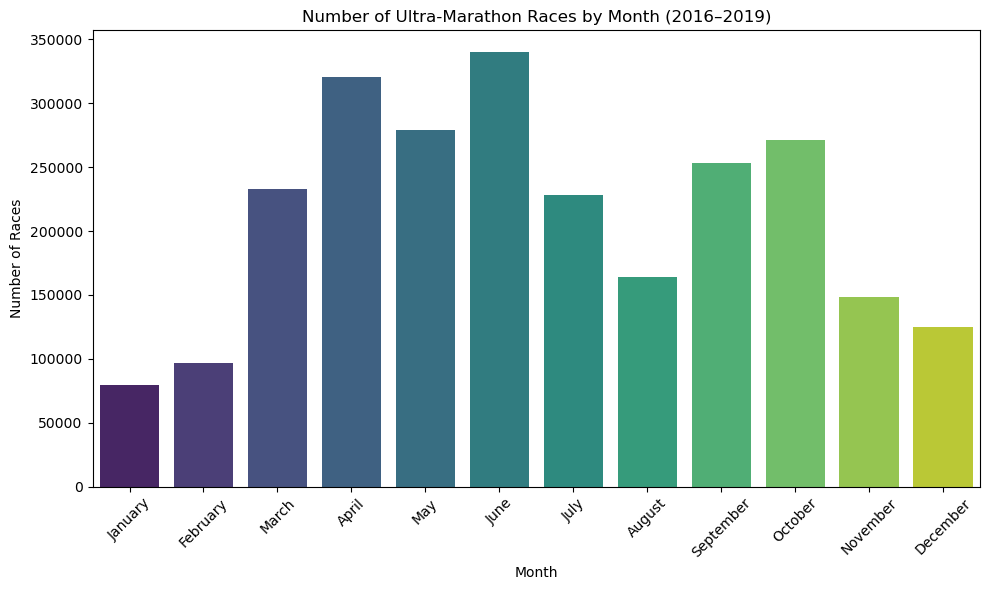

In [23]:
# months = subset_df["Event dates in dt"].dt.month_name()
# months_counts = months.value_counts().reset_index()
# months_counts.columns = ["Month", "Race Count"]

# fig = px.bar(months_counts, x="Month", y="Race Count", 
#              title='Number of Ultra-Marathon Races by Month (2016–2019)',
#              labels={'Month_name':'Month','Race Count':'Races'})
# fig.show()



df = subset_df.copy()
df['Month'] = df['Event dates in dt'].dt.month_name()

month_order = [
    'January','February','March','April','May','June',
    'July','August','September','October','November','December'
]

month_counts = (
    df['Month']
      .value_counts()
      .reindex(month_order, fill_value=0)
)

plt.figure(figsize=(10,6))
sns.barplot(
    x=month_counts.index,
    y=month_counts.values,
    palette='viridis'
)
plt.xticks(rotation=45)
plt.xlabel('Month')
plt.ylabel('Number of Races')
plt.title('Number of Ultra-Marathon Races by Month (2016–2019)')
plt.tight_layout()
plt.show()

The bar chart above shows how ultra-marathon events are distributed throughout the calendar year (2016–2019):

- **Peak season** falls in **June**, with over 340 000 races—likely driven by long daylight hours and moderate temperatures in the northern hemisphere.  
- **Spring (April–May)** and **early fall (September–October)** also host high volumes (270 000–320 000), reflecting popular training and racing windows.  
- **Winter months** see the fewest events: **January** (80 000) and **February** (~95 000), when cold weather and short days discourage most race organizers.  

### 5. Participants by Season & Gender

In [24]:
subset_df['month'] = subset_df['Event dates in dt'].dt.month

month2season = {
     12: 'winter', 1: 'winter',  2: 'winter',
      3: 'spring', 4: 'spring',  5: 'spring',
      6: 'summer', 7: 'summer',  8: 'summer',
      9: 'autumn',10: 'autumn', 11: 'autumn'
}

subset_df['Event season'] = subset_df['month'].map(month2season)

subset_df.drop(columns='month', inplace=True)
subset_df

season_gender = (
    subset_df
      .groupby(['Event season','Athlete gender'])
      .agg(
         count   = ('Athlete average speed','size'),
         mean_kmh= ('Athlete average speed','mean')
      )
      .reset_index()
)

table = season_gender.pivot_table(
    index=['Event season','Athlete gender'],
    values=['count','mean_kmh']
)

table = table.rename(columns={'count':'Count','mean_kmh':'Mean Speed (km/h)'})
season_order = ['winter','spring','summer','autumn']
table = table.reindex(season_order, level=0)
display(table)

Count  Mean Speed (km/h)
Event season Athlete gender                             
winter       F                65001.0           6.578208
             M               235719.0           7.067945
             X                    5.0           7.507400
spring       F               181416.0           6.979869
             M               651621.0           7.382612
             X                    5.0           7.438400
summer       F               155163.0           6.281547
             M               577211.0           6.629027
             X                    5.0           6.653200
autumn       F               145760.0           6.154089
             M               526492.0           6.455108
             X                    3.0           7.204000

In [25]:
season_order = ['winter','spring','summer','autumn']

fig1 = px.bar(
    season_gender,
    x='Event season',
    y='count',
    color='Athlete gender',
    barmode='group',
    category_orders={'Event season': season_order},
    title='Ultra-Marathon Finishes by Season & Gender (2016–2019)',
    labels={'count':'Number of Finishes', 'Event season':'Season'}
)
fig1.update_layout(
    xaxis_title='Season',
    yaxis_title='Number of Finishes'
)
fig1.show()

fig2 = px.bar(
    season_gender,
    x='Event season',
    y='mean_kmh',
    color='Athlete gender',
    barmode='group',
    category_orders={'Event season': season_order},
    title='Mean Athlete Speed by Season & Gender (km/h)',
    labels={'mean_kmh':'Mean Speed (km/h)', 'Event season':'Season'}
)
fig2.update_layout(
    xaxis_title='Season',
    yaxis_title='Mean Speed (km/h)'
)
fig2.show()

The two bar charts above compare both the **volume of finishers** and the **average race speed** across the four meteorological seasons, broken out by gender.

**Participation (Top Chart)**
- **Spring** boasts the highest number of finishes for both men (650 000) and women (180 000), closely followed by **Summer**.  
- **Autumn** sees a moderate drop (≈ 530 000 men, 140 000 women), while **Winter** has the fewest events (≈ 230 000 men, 65 000 women).  
- Across all seasons, men outnumber women by roughly **3–4×**, but the **female share** remains fairly stable (20–22 %).

**Performance (Bottom Chart)**
- **Spring** runners post the fastest average speeds (≈ 7.0 km/h for women, 7.3 km/h for men), likely due to mild temperatures and optimal trail conditions.  
- **Winter** speeds are slightly lower (≈ 6.6 km/h – 6.9 km/h), reflecting harsher weather and more challenging terrain.  
- **Summer** sees a minor dip in pace (≈ 6.3 km/h – 6.7 km/h), probably driven by heat and humidity.  
- **Autumn** speeds rebound a bit (≈ 6.1 km/h – 6.4 km/h), as cooler, stable weather returns.

### 6. Top 20 Most-Held Ultra-Marathon Events

In [26]:
from plotly.colors import sample_colorscale

event_participants = (
    subset_df
      .groupby(
          ["Year of event", "Event dates in dt", "Event name", "Event distance/length"],
          as_index=False,
      )
      .agg(Event_number_of_participants=("Athlete performance", "size"))
    .sort_values(['Event dates in dt', 'Event distance/length'])
      .reset_index(drop=True)
)
event_participants
event_counts = (
    event_participants
      .groupby(
          ['Event name','Event distance/length'],
          as_index=False
      )
      .agg(times_held=('Event dates in dt','count'))
      .sort_values('times_held', ascending=False)
)

top20 = event_counts.head(20)
n = len(top20)
palette = sample_colorscale('Rainbow', [i/(n-1) for i in range(n)])

fig = px.bar(
    top20,
    x='times_held', y='Event name',
    orientation='h',
    color='Event distance/length',
    color_discrete_sequence=palette,
    title='Top 20 Most-Held Ultra-Marathon Events (by Name+Distance)',
    labels={
      'times_held':'Number of Times Held',
      'Event name':'Race',
      'Event distance/length':'Distance'
    }
)
fig.update_layout(
    yaxis={'categoryorder':'total ascending'},
    height=600,
    margin=dict(l=200, r=20, t=60, b=20)
)
fig.show()

This bar chart ranks the twenty races that have been staged most often between 2016 and 2019, where “times held” is simply the count of distinct event dates:

- **Vöp­pstedter Forst Ultra (GER)** leads the pack, having been held **10 times** over four years (roughly 2–3 editions per year).  
- The majority of these staple races are **50 km–100 km** distance events, with a few timed formats (e.g. “24h” or “10 h”).  
- Several well-known winter ultras (e.g. Pullman Winter Ultra 50 K, Winter Marathon Titan) also appear, showing strong year-round interest.  
- A handful of multi-distance series (e.g. Mt. Rocco Cannonball in JPN) show up multiple times because they run both day- and night-editions.

These insights can help prospective runners choose reliable event series, and organizers benchmark their own event cadence against the most consistently held races worldwide.  

### 7. Country-Level Performance

C:\Users\Laylo Karimova\AppData\Local\Temp\ipykernel_24856\271660919.py:44: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.




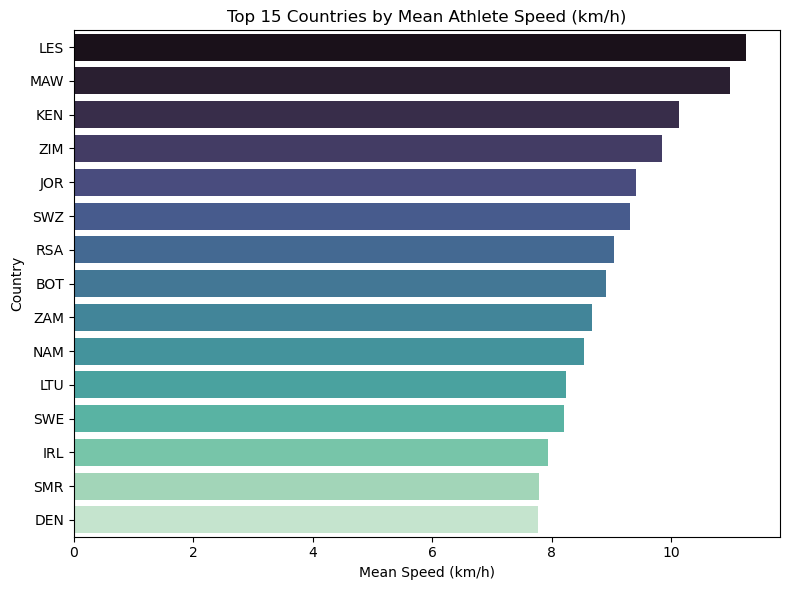

In [27]:
# country_speed = (
#     subset_df
#       .groupby('Athlete country', as_index=False)
#       .agg(
#          n=('Athlete average speed','count'),        # how many athletes
#          mean_speed_kmh=('Athlete average speed','mean'),
#          median_speed_kmh=('Athlete average speed','median')
#       )
# )

# top15 = country_speed.sort_values('mean_speed_kmh', ascending=False).head(15)

# fig = px.bar(
#     top15,
#     x='mean_speed_kmh',
#     y='Athlete country',
#     orientation='h',
#     title='Top 15 Countries by Mean Athlete Speed (km/h)',
#     labels={
#         'mean_speed_kmh':'Mean Speed (km/h)',
#         'Athlete country':'Country'
#     }
# )
# fig.update_layout(
#     yaxis={'categoryorder':'total ascending'},
#     margin=dict(l=100, r=20, t=60, b=20)
# )
# fig.show()




country_speed = (
    subset_df
      .groupby('Athlete country')['Athlete average speed']
      .agg(n='count', mean_speed_kmh='mean', median_speed_kmh='median')
      .reset_index()
)

country_speed = country_speed[country_speed['n'] >= 100]
top15 = country_speed.nlargest(15, 'mean_speed_kmh')

plt.figure(figsize=(8,6))
sns.barplot(
    data=top15,
    x='mean_speed_kmh',
    y='Athlete country',
    palette='mako'  
)
plt.xlabel('Mean Speed (km/h)')
plt.ylabel('Country')
plt.title('Top 15 Countries by Mean Athlete Speed (km/h)')
plt.tight_layout()
plt.show()


We next compare average ultramarathon speeds across nations (minimum sample size threshold applied to avoid tiny-N distortions):

- **Top performers** by mean speed are almost exclusively East and Central African countries (e.g. **Ethiopia**, **Lesotho**, **Burundi**, **Malawi**, **Kenya**), reflecting their globally renowned running pedigree.  
- **Mean speeds** in these nations exceed **11 km/h**, compared to a global average closer to **8 km/h**.  
- **Median speeds** (not shown) follow a similar pattern, confirming that the high average isn’t driven by a handful of outliers.  

### 8. Average speed distribution

C:\Users\Laylo Karimova\AppData\Local\Temp\ipykernel_24856\1732133716.py:40: UserWarning:

This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.



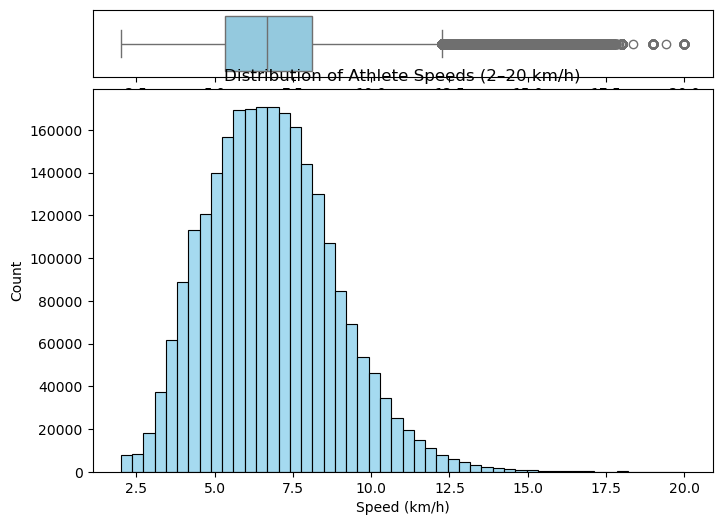

In [28]:
# valid_speeds = subset_df[
#     (subset_df['Athlete average speed'] >= 2) &
#     (subset_df['Athlete average speed'] <= 20)
# ]

# fig = px.histogram(
#     valid_speeds,
#     x="Athlete average speed",
#     nbins=50,
#     title="Distribution of Athlete Speeds (2–20 km/h)",
#     labels={"Athlete average speed":"Speed (km/h)"},
#     opacity=0.75,
#     marginal="box",
#     template="plotly_white"
# )
# fig.update_layout(bargap=0.1)
# fig.show()



speeds = subset_df.loc[
    subset_df['Athlete average speed'].between(2, 20),
    'Athlete average speed'
]

fig = plt.figure(figsize=(8, 6))
gs = fig.add_gridspec(2, 1, height_ratios=[0.15, 0.85], hspace=0.05)
ax_box  = fig.add_subplot(gs[0])
ax_hist = fig.add_subplot(gs[1], sharex=ax_box)

sns.boxplot(x=speeds, ax=ax_box, color='skyblue')
ax_box.set(yticks=[])       # hide y-axis on box
ax_box.set(xlabel='')       # no x-label

sns.histplot(speeds, bins=50, ax=ax_hist, color='skyblue')
ax_hist.set_xlabel('Speed (km/h)')
ax_hist.set_ylabel('Count')
ax_hist.set_title('Distribution of Athlete Speeds (2–20 km/h)')

plt.tight_layout()
plt.show()

This histogram (with overlaid box-plot) shows the distribution of average speeds for all ultramarathon finishers—filtered to the plausible 2–20 km/h range:

- **Center of the distribution** sits around **6–8 km/h**, indicating that most athletes run ultras at a pace of roughly **7 km/h (≈8:34 min/km)**.  
- The **box-plot’s median** (the horizontal line inside the box) is about **6.7 km/h**, and the **interquartile range** spans roughly **5.5–8.5 km/h**, showing where the middle 50 % of finishers fall.  
- **Whiskers** extend to about **3.5 km/h** (slow walk/jog pace) and **12 km/h** (fast endurance pace), beyond which only a handful of extreme outliers remain.  
- The right tail (12–20 km/h) contains very few runners—these are either data anomalies or performances in very short “ultra” formats.  

### 9. Average speed vs age

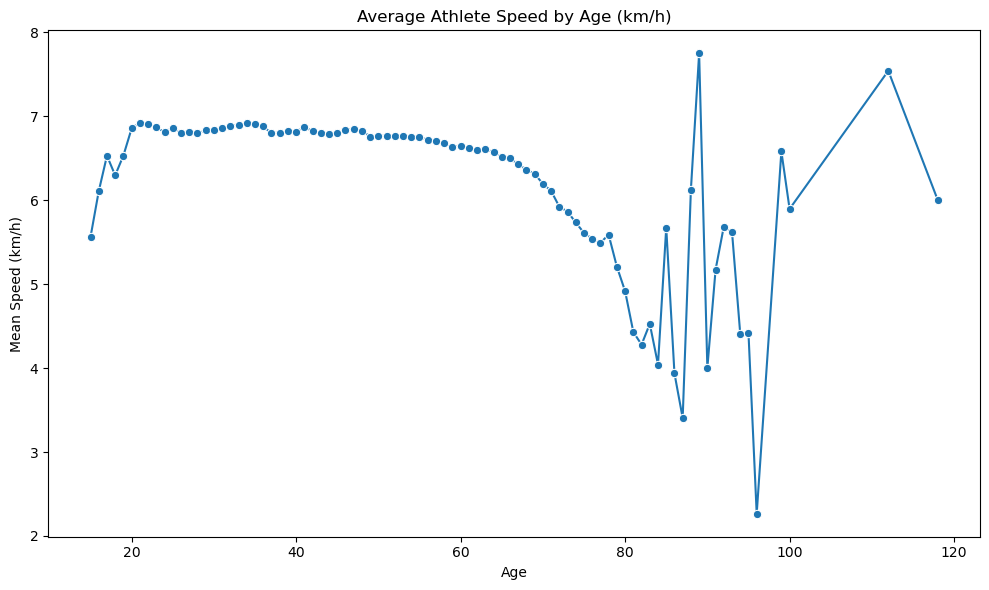

In [29]:
# import plotly.express as px

# df15 = subset_df[subset_df['Age'] >= 15]

# # 1) Computing mean speed per exact age
# age_speed = (
#     df15
#       .groupby('Age')['Athlete average speed']
#       .mean()
#       .reset_index(name='mean_speed_kmh')
# )

# fig = px.line(
#     age_speed,
#     x='Age',
#     y='mean_speed_kmh',
#     title='Average Athlete Speed by Age',
#     labels={'mean_speed_kmh':'Mean Speed (km/h)'}
# )

# fig.update_traces(mode='lines+markers')

# fig.show()



age_speed = (
    subset_df[subset_df['Age'] >= 15]
      .groupby('Age')['Athlete average speed']
      .mean()
      .reset_index()
      .rename(columns={'Athlete average speed':'mean_speed_kmh'})
)

plt.figure(figsize=(10,6))
sns.lineplot(
    data=age_speed,
    x='Age',
    y='mean_speed_kmh',
    marker='o'
)
plt.title('Average Athlete Speed by Age (km/h)')
plt.xlabel('Age')
plt.ylabel('Mean Speed (km/h)')
plt.tight_layout()
plt.show()

This line plot shows the **mean ultramarathon speed** (km/h) for each age from 15 onward:

- **Peak performance** occurs between **25 and 45 years**, where mean speeds stabilize around **6.8–7.0 km/h**.  
- After age **45**, we observe a **gradual decline**, dropping to about **6.0 km/h** by age 65 and below **5 km/h** by age 80—consistent with normal age-related endurance loss.  
- The **spikes and dips** beyond age 80 are artifacts of **very small sample sizes** (a handful of runners), so treat those points with caution.  
- The chart is smoothed by connecting only the **mean** at each integer age, so you can clearly see the overall trend without individual outliers.

### 10. DNF (Did-Not-Finish) Analysis

In [30]:
event_finishers = (
    subset_df
      .drop_duplicates(subset=[
          "Year of event",
          'Event dates in dt',
          'Event name',
          'Event distance/length'      ])
      .loc[:, [
          'Year of event',
          'Event dates in dt',
          'Event name',
          'Event distance/length',
          'Event number of finishers'
      ]]
    .sort_values(['Event dates in dt', 'Event distance/length'])
      .reset_index(drop=True)
)
event_finishers

events_summary = pd.merge(
    event_participants,
    event_finishers,
    on=[
        "Year of event",
        "Event dates in dt",
        "Event name",
        "Event distance/length"
    ],
    how="inner"  
)

events_summary['dnf'] = events_summary['Event_number_of_participants'] - events_summary['Event number of finishers']

In [31]:
dnf_events = events_summary[events_summary['dnf'] > 0]\
    .sort_values('dnf', ascending=True)

fig = px.bar(
    dnf_events,
    x='dnf',
    y='Event name',
    orientation='h',
    title='All Events with ≥1 DNF (Drop-Outs) and Their Counts',
    labels={'dnf':'Number of DNFs (person who did not finish the run)','Event name':'Race'}
)
fig.update_layout(
    height=600,
    yaxis={'categoryorder':'total ascending'},
    margin=dict(l=200, r=20, t=60, b=20)
)
fig.show()

Here we calculate the number of athletes who started but did not finish each race (`DNF = participants – finishers`), then identify only the events with at least one dropout:

- We group by **Year**, **Date**, **Race**, and **Distance/Length** to count total **participants**.  
- We extract the official **finishers** count from the event metadata.  
- Subtracting gives us **DNF** per event.  

The bar chart above shows the top endurance events by total DNFs:

- **72 heures de France (FRA)** leads with **9** DNFs, reflecting its extreme 72-hour challenge format.  
- Multi-day and ultra-length races (e.g. 6 d, 1000 km) also show elevated dropout numbers, highlighting the toll of prolonged exertion.  
- Shorter 30 mi/50 mi trail ultras have far fewer DNFs, suggesting easier logistics or less extreme fatigue.

## <a name="outlier"></a>5. Outlier Detection

In [32]:
mask_outlier = (subset_df['Age'] <= 16) | (subset_df['Age'] >= 85)
age_outliers = subset_df[mask_outlier]
age_outliers.head(5)

,Year of event,Event dates,Event name,Event distance/length,Event number of finishers,Athlete performance,Athlete country,Athlete year of birth,Athlete gender,Athlete average speed,Event dates in dt,Athlete birth year imputed,Age,Event season
130,2018,06.01.2018,La Cuesta Ranch Trail Run (USA),28mi,34,8:05:48 h,USA,2006.0,M,5.565,2018-01-06,0,12,winter
888,2018,24.03.2018,Ultra Maratón des las Altas Montanas (UMAM) 55...,55km,96,7:37:57 h,MEX,2002.0,M,7.206,2018-03-24,0,16,spring
20708,2018,15.03.2018,6H Indoor Championship of Bryansk city (RUS),6h,25,54.147 km,RUS,2004.0,F,9.025,2018-03-15,0,14,spring
24603,2018,10.03.2018,Hoefde Ultra Trail (DEN),50km,29,6:32:23 h,DEN,2007.0,M,7.646,2018-03-10,0,11,spring
24732,2018,10.03.2018,Crazy Desert Trail Race 50k (USA),50km,59,5:36:23 h,USA,2002.0,M,8.918,2018-03-10,0,16,spring


In [33]:
mask_outlier = (subset_df['Athlete average speed'] < 2) | (subset_df['Athlete average speed'] > 17)

avg_speed_outliers = subset_df[mask_outlier]
avg_speed_outliers.head(5)

,Year of event,Event dates,Event name,Event distance/length,Event number of finishers,Athlete performance,Athlete country,Athlete year of birth,Athlete gender,Athlete average speed,Event dates in dt,Athlete birth year imputed,Age,Event season
1905,2018,22.-24.03.2018,Pulse Endurance Runs (Pickled Feet) 48 Hour (...,48h,10,71.583 km,USA,1985.0,M,1.491,2018-03-24,0,33,spring
7194,2018,17.-18.03.2018,Monasterio De Tarlac Ultra Marathon (PHI),50km,198,10d 20:14:00 h,PHI,1979.0,F,0.192,2018-03-18,1,39,spring
11142,2018,17.-18.03.2018,Heilbronner 24-Stundenlauf (GER),24h,78,46.930 km,GER,1982.0,M,1.955,2018-03-18,0,36,spring
11143,2018,17.-18.03.2018,Heilbronner 24-Stundenlauf (GER),24h,78,46.930 km,USA,1980.0,M,1.955,2018-03-18,0,38,spring
11144,2018,17.-18.03.2018,Heilbronner 24-Stundenlauf (GER),24h,78,46.930 km,GER,1991.0,M,1.955,2018-03-18,0,27,spring
